In [1]:
# Import the necessary modules
# Important is torch.nn, torchvision, and DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import scipy.io

In [2]:
# Mount the device onto the GPU but if no GPU mount onto the CPU
# With GPU we have access to cuda capability, where we can parallelize the processing
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
# Define the image transformations
# Incoming images are 224x224
# Normalize them so that all data is same
image_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'valid': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}


In [4]:
# From where the pre-processed data was split into train, val, test
# Now define them into train_dataset, valid_dataset and test_dataset
# All of which are with batch size 32
data_dir = "Kevin-MIE1517-processeddata"
batch_size = 64

train_dataset = datasets.ImageFolder(root=f"{data_dir}/train", transform=image_transforms['train'])
valid_dataset = datasets.ImageFolder(root=f"{data_dir}/valid", transform=image_transforms['valid'])
test_dataset = datasets.ImageFolder(root=f"{data_dir}/test", transform=image_transforms['test'])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True)


In [5]:
# Define a class where we use frozen ResNet-152 model and just modify last layer to be
# a fully-connected layer where we have mutliclass-classification 1-196 different classes
# Note: we are only training on the classifier not on the frozen ResNet-152 prior layers
class EfficientNetWithClassifier(nn.Module):
    def __init__(self, num_classes=196, dropout_rate=0.3):
        super(EfficientNetWithClassifier, self).__init__()
        # load the pretrained EfficientNet model which is much better than resnet-152 with much less parameters
        self.backbone = models.efficientnet_v2_s(weights='IMAGENET1K_V1')
        
        # freeze only the early layers (keep last few blocks trainable) 
        # this way we can train the last few blocks to classify the car models 
        # without affecting the pre-trained features and make our model more task-specific
        # this prevents overfitting and makes our model more generalizable

        ct = 0
        for child in self.backbone.features.children():
            ct += 1
            if ct < 7:  # freeze first 6 blocks
                for param in child.parameters():
                    param.requires_grad = False
        
        # get the number of features this is 1280 for efficientnet-v2-s
        num_features = self.backbone.classifier[1].in_features
        
        # enhanced classifier with batch normalization, dropout, and GELU activation
        # GELU often performs better than ReLU activation function
        # GELU is a smooth activation function that is similar to ReLU but with a slightly different shape
        # The smoother gradient helps with stabilizing the learning process and can lead to better performance
        # batch normalization helps with stabilizing the learning process
        # dropout helps with preventing overfitting

        self.classifier = nn.Sequential(
            # first block
            nn.BatchNorm1d(num_features),
            nn.Dropout(p=dropout_rate),
            nn.Linear(num_features, 1024),
            nn.BatchNorm1d(1024),
            nn.GELU(),
            
            # second block  
            nn.Dropout(p=dropout_rate),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.GELU(),
            
            # third block
            nn.Dropout(p=dropout_rate),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.GELU(),
            
            # final classification layer
            nn.Dropout(p=dropout_rate/2),  # lower dropout at final layer
            nn.Linear(256, num_classes)
        )
        
        # initialize weights properly
        self._initialize_weights()
        
    def _initialize_weights(self):
        for m in self.classifier.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm1d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        features = self.backbone.features(x)
        # global average pooling
        # we use global average pooling to reduce the spatial dimensions of the features
        # this helps with reducing the number of parameters and preventing overfitting
        features = self.backbone.avgpool(features)
        features = torch.flatten(features, 1)
        # apply classifier
        return self.classifier(features)

In [6]:
# Instantiate the ResNet-152 model as an object and mount to GPU device
# Define the criterion as CrossEntropyLoss() as this is a multiclass-classification problem
# Set the opitmizer to be the Adam optimizer with learning rate of 0.001
efficientnet_model = EfficientNetWithClassifier(num_classes=196).to(device)  # Ensure the entire model is on the GPU
# Gradient clipping to prevent exploding gradients
torch.nn.utils.clip_grad_norm_(efficientnet_model.parameters(), max_norm=1.0)
num_epochs = 20

# Learning rate scheduler
optimizer = optim.AdamW(efficientnet_model.parameters(), lr=0.001, weight_decay=0.01)
scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=0.001,
    epochs=num_epochs,
    steps_per_epoch=len(train_loader),
    pct_start=0.3  # Warm-up for first 30% of training
)

# Loss function with label smoothing
criterion = nn.CrossEntropyLoss(label_smoothing=0.1)

In [7]:
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=4, pin_memory=True)

In [9]:
# evaluate the model on test set
# load the model
total = 0
correct = 0

# Load the complete checkpoint instead of just the state dict
checkpoint = torch.load("best_efficientnet_v2_s.pth")
efficientnet_model.load_state_dict(checkpoint['model_state_dict'])
efficientnet_model.eval()

with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = efficientnet_model(images)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

# Calculate accuracy
accuracy = correct / total
print(f"Accuracy of the model on the test set: {accuracy:.4f}")


/tmp/ipykernel_2551665/2471401752.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("best_efficientnet_v2_s.pth")


Accuracy of the model on the test set: 0.8662


In [10]:
import numpy as np
class_name_list = scipy.io.loadmat('../stanford-cars-dataset/cars_annos.mat')['class_names'].flatten()
class_name_list = list(map(lambda x: x[0],class_name_list))


Predictions vs Actual Labels:

Image 1:
Predicted: BMW M3 Coupe 2012
Actual: BMW M3 Coupe 2012

Image 2:
Predicted: GMC Yukon Hybrid SUV 2012
Actual: GMC Yukon Hybrid SUV 2012

Image 3:
Predicted: Audi S5 Convertible 2012
Actual: Audi S5 Convertible 2012

Image 4:
Predicted: Lamborghini Aventador Coupe 2012
Actual: Lamborghini Aventador Coupe 2012


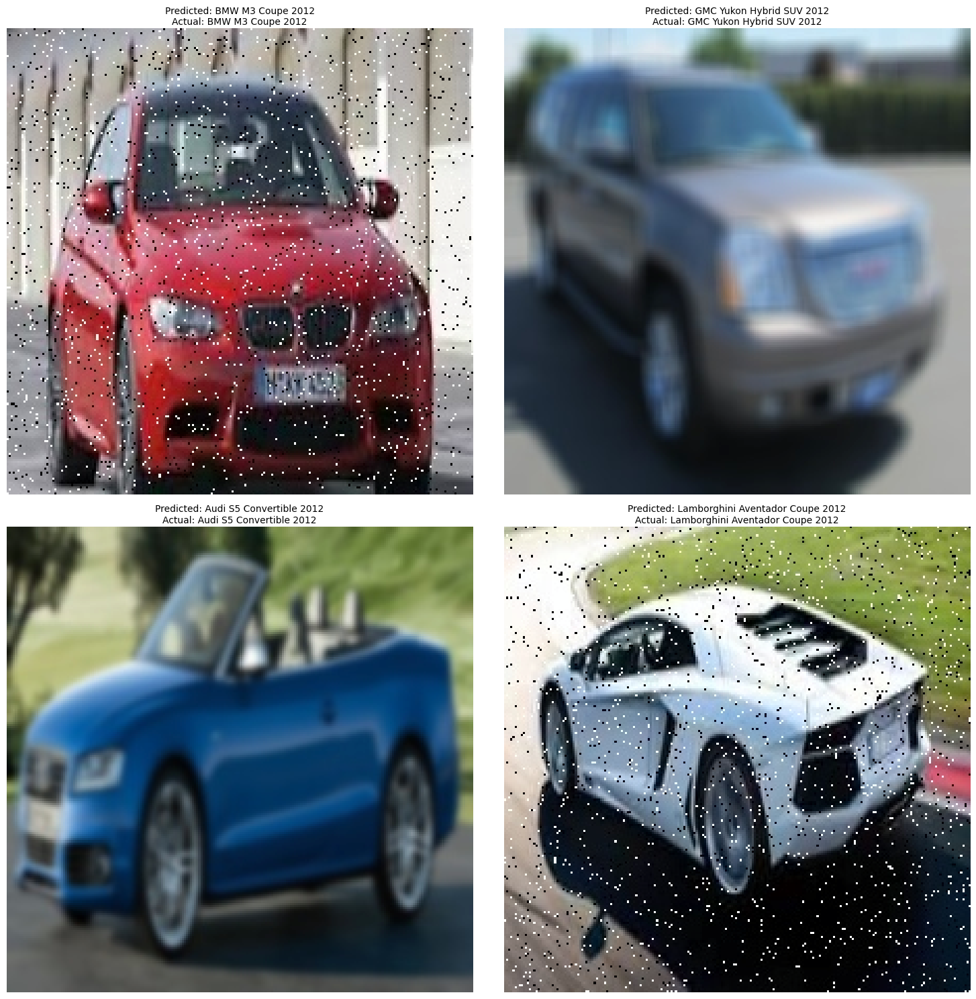


Batch Accuracy: 92.19%


In [14]:
# Get class names and evaluate a batch
class_names = train_dataset.classes

with torch.no_grad():
    # Get one batch of test images
    images, labels = next(iter(test_loader))
    images, labels = images.to(device), labels.to(device)
    outputs = efficientnet_model(images)
    _, predicted = torch.max(outputs, 1)

    # Print first few predictions and actual labels
    print("\nPredictions vs Actual Labels:")
    for i in range(4):
        print(f"\nImage {i+1}:")
        print(f"Predicted: {class_name_list[predicted[i]]}")
        print(f"Actual: {class_name_list[labels[i]]}")

    # Visualize predictions
    plt.figure(figsize=(15, 15))
    for i in range(4):
        plt.subplot(2, 2, i+1)
        # denormalize the image
        img = images[i].cpu().numpy().transpose(1, 2, 0)
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = np.clip(img, 0, 1)
        
        plt.imshow(img)
        plt.title(f"Predicted: {class_name_list[predicted[i]]}\nActual: {class_name_list[labels[i]]}", 
                fontsize=10, wrap=True)
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('predictions.png')  # Save the figure
    plt.show()

# Calculate and print overall accuracy
correct = (predicted == labels).sum().item()
total = labels.size(0)
print(f"\nBatch Accuracy: {100 * correct / total:.2f}%")

In [36]:
from PIL import Image

# process one sample image from current directory
sample_image = Image.open("ran.jpg")
sample_image = image_transforms['test'](sample_image)
sample_image = sample_image.unsqueeze(0)
sample_image = sample_image.to(device)
output = efficientnet_model(sample_image)

# print the predicted class
print(f"Predicted class: {class_name_list[output.argmax().item()]}")


Predicted class: Bugatti Veyron 16.4 Coupe 2009


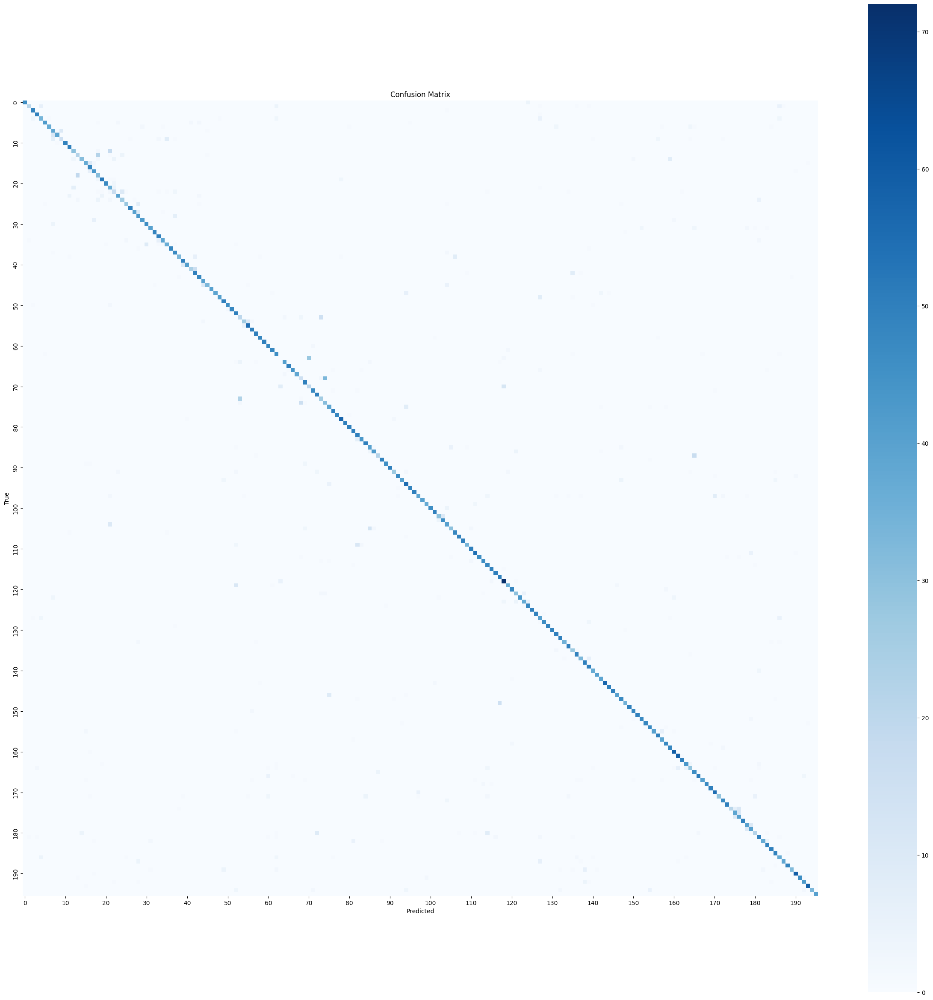


Per-class accuracy:
Class 0: 0.920
Class 1: 0.525
Class 2: 0.980
Class 3: 0.980
Class 4: 0.680
Class 5: 0.840
Class 6: 0.740
Class 7: 0.760
Class 8: 0.780
Class 9: 0.375
Class 10: 0.980
Class 11: 1.000
Class 12: 0.600
Class 13: 0.440
Class 14: 0.620
Class 15: 0.740
Class 16: 0.960
Class 17: 0.860
Class 18: 0.620
Class 19: 0.867
Class 20: 0.940
Class 21: 0.720
Class 22: 0.425
Class 23: 0.800
Class 24: 0.650
Class 25: 0.700
Class 26: 1.000
Class 27: 0.800
Class 28: 0.860
Class 29: 0.840
Class 30: 0.920
Class 31: 0.800
Class 32: 0.980
Class 33: 1.000
Class 34: 0.780
Class 35: 0.720
Class 36: 0.960
Class 37: 0.940
Class 38: 0.660
Class 39: 1.000
Class 40: 0.820
Class 41: 0.600
Class 42: 0.833
Class 43: 0.960
Class 44: 1.000
Class 45: 0.660
Class 46: 1.000
Class 47: 0.780
Class 48: 0.820
Class 49: 1.000
Class 50: 0.920
Class 51: 0.960
Class 52: 1.000
Class 53: 0.500
Class 54: 0.650
Class 55: 0.917
Class 56: 1.000
Class 57: 1.000
Class 58: 0.960
Class 59: 1.000
Class 60: 0.960
Class 61: 0.9

In [13]:
# confusion matrix 14 x 14
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Get predictions for the entire test set
efficientnet_model.eval()
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = efficientnet_model(images)
        _, predicted = torch.max(outputs, 1)
        
        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Create confusion matrix
cm = confusion_matrix(all_labels, all_preds)

# Plot confusion matrix using seaborn
plt.figure(figsize=(30, 30))  # Increase figure size for better legibility
sns.heatmap(cm, cmap='Blues', cbar=True, square=True, xticklabels=10, yticklabels=10)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.savefig('confusion_matrix.png', bbox_inches='tight', dpi=300) 
plt.show()

# Calculate per-class accuracy
per_class_accuracy = cm.diagonal() / cm.sum(axis=1)
print("\nPer-class accuracy:")
for i, acc in enumerate(per_class_accuracy):
    print(f"Class {i}: {acc:.3f}")

In [15]:
# Get the indices of classes sorted by accuracy (worst to best)
worst_performing_idx = np.argsort(per_class_accuracy)

# Show the 5 worst performing classes
print("\nWorst performing classes by accuracy:")
for idx in worst_performing_idx[:5]:
    print(f"{class_name_list[idx]}: {per_class_accuracy[idx]:.3f}")

# Get misclassifications for worst performing classes
worst_class_misclass = {}
for idx in worst_performing_idx[:5]:
    # Get indices where true label was this class
    true_class_mask = np.array(all_labels) == idx
    # Get predictions for these instances
    preds_for_class = np.array(all_preds)[true_class_mask]
    # Get incorrect predictions
    incorrect_preds = preds_for_class[preds_for_class != idx]
    # Count frequency of each incorrect prediction
    unique, counts = np.unique(incorrect_preds, return_counts=True)
    misclass_dict = dict(zip([class_name_list[i] for i in unique], counts))
    worst_class_misclass[class_name_list[idx]] = misclass_dict





Worst performing classes by accuracy:
Chevrolet Express Cargo Van 2007: 0.000
Chevrolet Silverado 2500HD Regular Cab 2012: 0.300
Aston Martin Virage Convertible 2012: 0.375
Audi S4 Sedan 2012: 0.425
Audi TTS Coupe 2012: 0.440


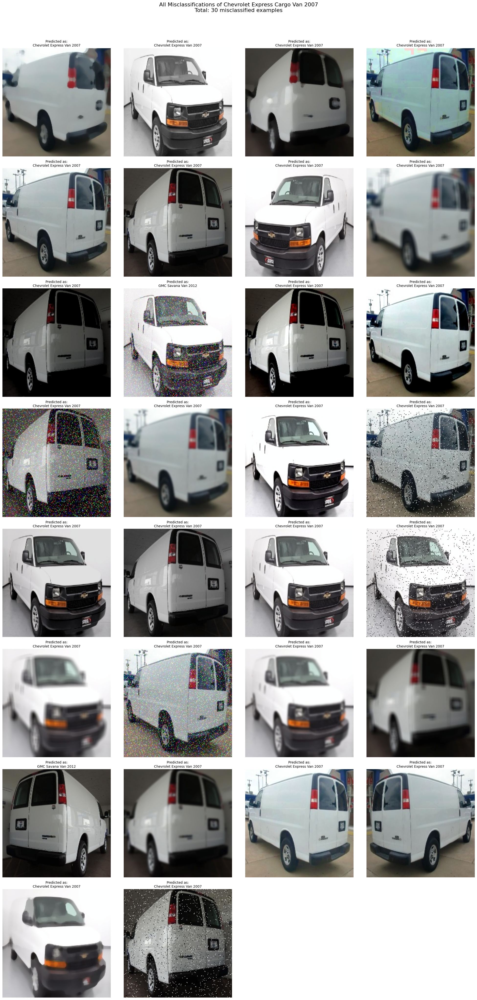


Total misclassifications for Chevrolet Express Cargo Van 2007: 30

Misclassification breakdown:
Chevrolet Express Van 2007: 28 times
GMC Savana Van 2012: 2 times


In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Get the worst performing class data
worst_idx = worst_performing_idx[0]
worst_class = class_name_list[worst_idx]

# Find all misclassified examples
efficientnet_model.eval()
examples = []
predictions = []
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        mask = (labels == worst_idx)
        if not mask.any():
            continue
            
        outputs = efficientnet_model(images[mask])
        _, predicted = torch.max(outputs, 1)
        
        # Keep all misclassified examples
        wrong_predictions = predicted != labels[mask]
        if not wrong_predictions.any():
            continue
            
        for img, pred in zip(images[mask][wrong_predictions], predicted[wrong_predictions]):
            # Denormalize image
            img_np = img.cpu().numpy().transpose(1, 2, 0)
            img_np = img_np * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
            img_np = np.clip(img_np, 0, 1)
            examples.append(img_np)
            predictions.append(class_name_list[pred])

# Display all example images
if examples:
    # Calculate grid dimensions
    n_images = len(examples)
    n_cols = 4  # You can adjust this number
    n_rows = math.ceil(n_images / n_cols)
    
    plt.figure(figsize=(20, 5 * n_rows))
    # Modified title positioning
    plt.suptitle(f'All Misclassifications of {worst_class}\nTotal: {len(examples)} misclassified examples', 
                fontsize=16, 
                y=1.02)  # Moved title up by adjusting y parameter
    for i, (img, pred) in enumerate(zip(examples, predictions)):
        plt.subplot(n_rows, n_cols, i+1)
        plt.imshow(img)
        plt.title(f'Predicted as:\n{pred}', fontsize=10, wrap=True)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Print summary
    print(f"\nTotal misclassifications for {worst_class}: {len(examples)}")
    
    # Count frequency of each misclassification
    from collections import Counter
    pred_counts = Counter(predictions)
    print("\nMisclassification breakdown:")
    for pred, count in sorted(pred_counts.items(), key=lambda x: x[1], reverse=True):
        print(f"{pred}: {count} times")

In [17]:
# F1 score, precision, and recall
from sklearn.metrics import f1_score, precision_score, recall_score
f1 = f1_score(all_labels, all_preds, average=None)
precision = precision_score(all_labels, all_preds, average=None)
recall = recall_score(all_labels, all_preds, average=None)

# in a dataframe
import pandas as pd

scores_df = pd.DataFrame({
    'Class': class_name_list,
    'Precision': precision,
    'Recall': recall,
    'F1 Score': f1
})

# Display the DataFrame
scores_df

# in a matrix form with gradient
matrix_df = scores_df.style.background_gradient(cmap='coolwarm')
matrix_df

# in a table form with gradient
table_df = scores_df.style.background_gradient(cmap='coolwarm').set_table_styles(
    [{'selector': 'th', 'props': [('background-color', '#000000'), ('color', '#ffffff')]}]
)
table_df



,Class,Precision,Recall,F1 Score
0,AM General Hummer SUV 2000,1.000000,0.920000,0.958333
1,Acura RL Sedan 2012,0.913043,0.525000,0.666667
2,Acura TL Sedan 2012,0.907407,0.980000,0.942308
3,Acura TL Type-S 2008,0.942308,0.980000,0.960784
4,Acura TSX Sedan 2012,0.723404,0.680000,0.701031
5,Acura Integra Type R 2001,0.954545,0.840000,0.893617
6,Acura ZDX Hatchback 2012,0.973684,0.740000,0.840909
7,Aston Martin V8 Vantage Convertible 2012,0.593750,0.760000,0.666667
8,Aston Martin V8 Vantage Coupe 2012,0.951220,0.780000,0.857143
9,Aston Martin Virage Convertible 2012,0.600000,0.375000,0.461538



Overall Metrics:
Average F1 Score: 0.860
Average Precision: 0.871
Average Recall: 0.861


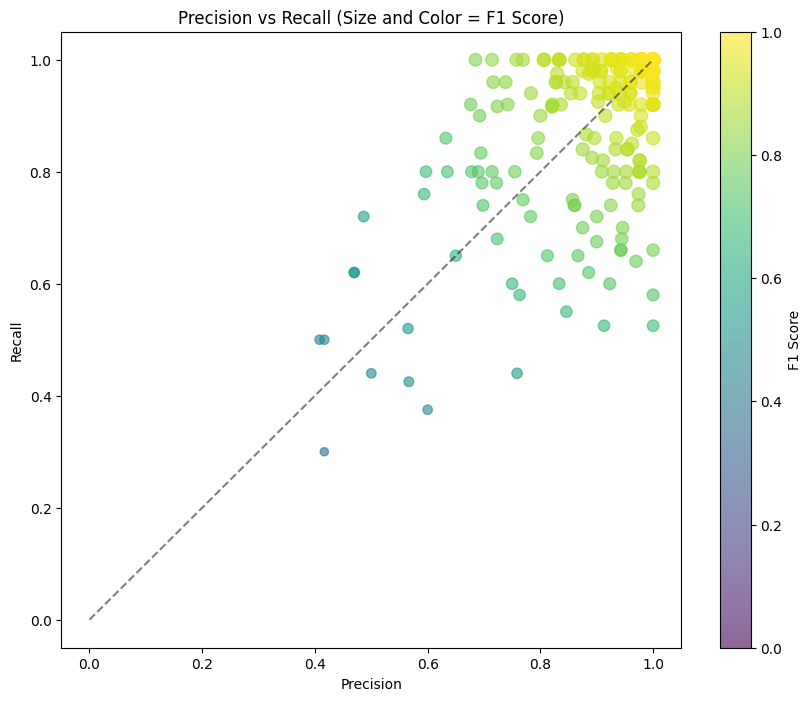


Top 10 Performing Classes:
                              Class  F1 Score  Precision  Recall
                Buick Regal GS 2012       1.0        1.0     1.0
              Chevrolet HHR SS 2010       1.0        1.0     1.0
           Dodge Charger SRT-8 2009       1.0        1.0     1.0
Chrysler Crossfire Convertible 2008       1.0        1.0     1.0
             Jeep Wrangler SUV 2012       1.0        1.0     1.0
    Lamborghini Reventon Coupe 2008       1.0        1.0     1.0
        Ford Expedition EL SUV 2009       1.0        1.0     1.0
         Honda Odyssey Minivan 2012       1.0        1.0     1.0
         Dodge Dakota Club Cab 2007       1.0        1.0     1.0
      smart fortwo Convertible 2012       1.0        1.0     1.0

Bottom 10 Performing Classes:
                                        Class  F1 Score  Precision  Recall
   Chevrolet Silverado 1500 Extended Cab 2012  0.541667   0.565217   0.520
                       Audi TT Hatchback 2011  0.534483   0.469697   0.620
 

In [18]:
import matplotlib.pyplot as plt

f1 = f1_score(all_labels, all_preds, average=None)
precision = precision_score(all_labels, all_preds, average=None)
recall = recall_score(all_labels, all_preds, average=None)

plt.figure(figsize=(10, 8))
scatter = plt.scatter(precision, recall, c=f1, cmap='viridis', 
                     s=100*f1, alpha=0.6)
plt.colorbar(scatter, label='F1 Score')
plt.plot([0, 1], [0, 1], 'k--', alpha=0.5)

plt.xlabel('Precision')
plt.ylabel('Recall')
plt.title('Precision vs Recall (Size and Color = F1 Score)')

print("\nOverall Metrics:")
print(f"Average F1 Score: {np.mean(f1):.3f}")
print(f"Average Precision: {np.mean(precision):.3f}")
print(f"Average Recall: {np.mean(recall):.3f}")

plt.show()

df = pd.DataFrame({
    'Class': class_name_list,  # Use class_name_list instead of range
    'F1 Score': f1,
    'Precision': precision,
    'Recall': recall
}).sort_values('F1 Score', ascending=False)

print("\nTop 10 Performing Classes:")
print(df.head(10).to_string(index=False))

print("\nBottom 10 Performing Classes:")
print(df.tail(10).to_string(index=False))

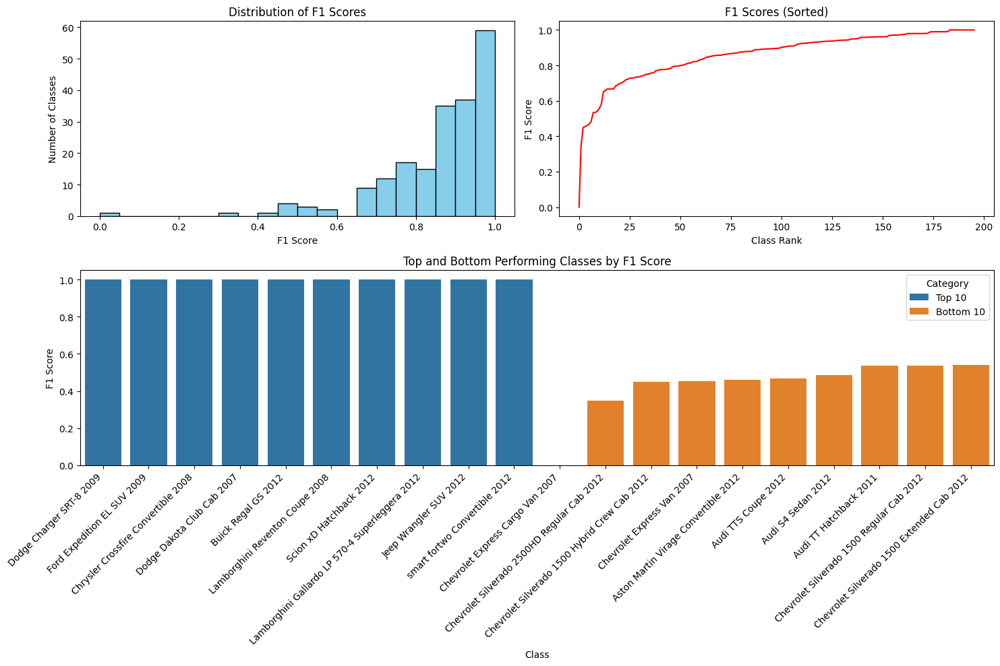


F1 Score Statistics:
Mean F1 Score: 0.860
Median F1 Score: 0.896
Standard Deviation: 0.143
Number of classes with F1 > 0.8: 144
Number of classes with F1 < 0.5: 7

Potential Problem Areas:

Classes performing below 0.717 (mean - std):
- Acura RL Sedan 2012: 0.667
- Acura TSX Sedan 2012: 0.701
- Aston Martin V8 Vantage Convertible 2012: 0.667
- Aston Martin Virage Convertible 2012: 0.462
- Audi A5 Coupe 2012: 0.667
- Audi TTS Coupe 2012: 0.468
- Audi TT Hatchback 2011: 0.534
- Audi S5 Coupe 2012: 0.581
- Audi S4 Sedan 2012: 0.486
- Audi TT RS Coupe 2012: 0.650
- Chevrolet Silverado 1500 Hybrid Crew Cab 2012: 0.449
- Chevrolet Express Cargo Van 2007: 0.000
- Chevrolet Silverado 2500HD Regular Cab 2012: 0.349
- Chevrolet Express Van 2007: 0.455
- Chevrolet Silverado 1500 Extended Cab 2012: 0.542
- Chevrolet Silverado 1500 Regular Cab 2012: 0.534
- Dodge Sprinter Cargo Van 2009: 0.667
- Ford F-450 Super Duty Crew Cab 2012: 0.698
- Honda Accord Coupe 2012: 0.684
- Mercedes-Benz S-Class Sed

In [19]:
# Create a more detailed F1 score analysis
plt.figure(figsize=(15, 10))

# Plot 1: Distribution of F1 Scores
plt.subplot(2, 2, 1)
plt.hist(f1, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of F1 Scores')
plt.xlabel('F1 Score')
plt.ylabel('Number of Classes')

# Plot 2: F1 Score vs Class Index (sorted)
plt.subplot(2, 2, 2)
sorted_f1 = np.sort(f1)
plt.plot(sorted_f1, 'r-')
plt.title('F1 Scores (Sorted)')
plt.xlabel('Class Rank')
plt.ylabel('F1 Score')

# Plot 3: Top and Bottom Performers
n_display = 10
top_indices = np.argsort(f1)[-n_display:]
bottom_indices = np.argsort(f1)[:n_display]

# Create summary DataFrame
summary_df = pd.DataFrame({
    'Class': [class_name_list[i] for i in np.concatenate([top_indices, bottom_indices])],
    'F1 Score': np.concatenate([f1[top_indices], f1[bottom_indices]]),
    'Category': ['Top '+str(n_display)]*n_display + ['Bottom '+str(n_display)]*n_display
})

# Plot the results
plt.subplot(2, 1, 2)
sns.barplot(data=summary_df, x='Class', y='F1 Score', hue='Category', dodge=False)
plt.xticks(rotation=45, ha='right')
plt.title('Top and Bottom Performing Classes by F1 Score')

plt.tight_layout()
plt.show()

# Print statistical summary
print("\nF1 Score Statistics:")
print(f"Mean F1 Score: {np.mean(f1):.3f}")
print(f"Median F1 Score: {np.median(f1):.3f}")
print(f"Standard Deviation: {np.std(f1):.3f}")
print(f"Number of classes with F1 > 0.8: {np.sum(f1 > 0.8)}")
print(f"Number of classes with F1 < 0.5: {np.sum(f1 < 0.5)}")

# Identify potential problem areas
print("\nPotential Problem Areas:")
problem_threshold = np.mean(f1) - np.std(f1)
problem_indices = np.where(f1 < problem_threshold)[0]
print(f"\nClasses performing below {problem_threshold:.3f} (mean - std):")
for idx in problem_indices:
    print(f"- {class_name_list[idx]}: {f1[idx]:.3f}")



Analysis for: Chevrolet Express Cargo Van 2007
F1 Score: 0.000
Precision: 0.000
Recall: 0.000

Most common misclassifications:
- Confused with Chevrolet Express Van 2007: 28 times
- Confused with GMC Savana Van 2012: 2 times


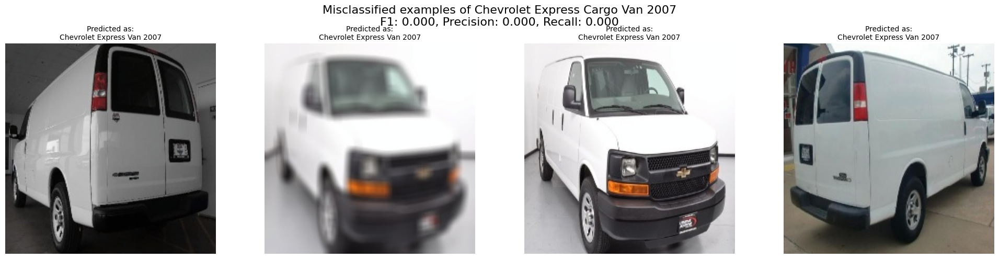



Analysis for: Chevrolet Silverado 2500HD Regular Cab 2012
F1 Score: 0.349
Precision: 0.417
Recall: 0.300

Most common misclassifications:
- Confused with Chevrolet Silverado 1500 Regular Cab 2012: 33 times
- Confused with Chevrolet Silverado 1500 Extended Cab 2012: 2 times


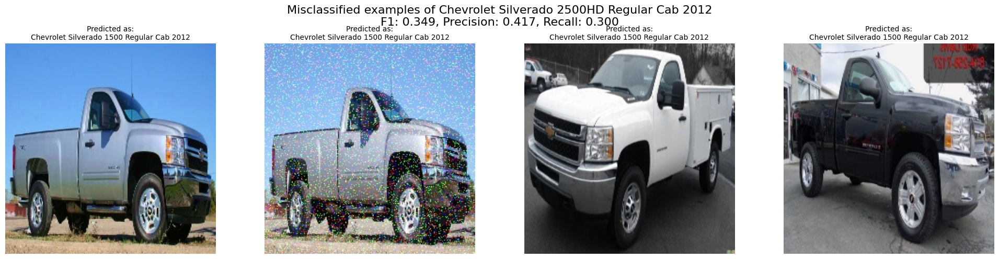



Analysis for: Chevrolet Silverado 1500 Hybrid Crew Cab 2012
F1 Score: 0.449
Precision: 0.408
Recall: 0.500

Most common misclassifications:
- Confused with Chevrolet Silverado 1500 Extended Cab 2012: 15 times
- Confused with Chevrolet Silverado 2500HD Regular Cab 2012: 3 times
- Confused with Chevrolet Avalanche Crew Cab 2012: 2 times


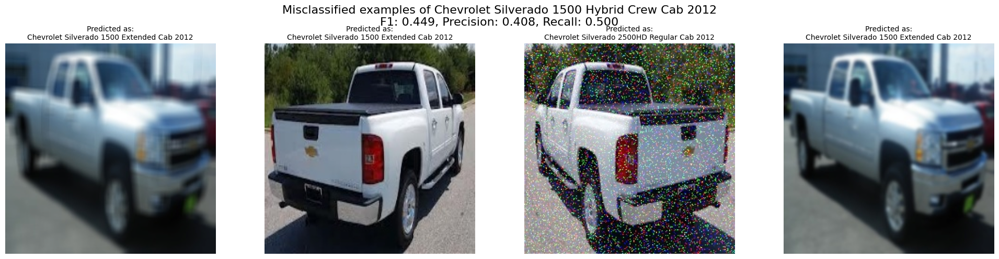



Analysis for: Chevrolet Express Van 2007
F1 Score: 0.455
Precision: 0.417
Recall: 0.500

Most common misclassifications:
- Confused with GMC Savana Van 2012: 12 times
- Confused with Chevrolet Express Cargo Van 2007: 8 times


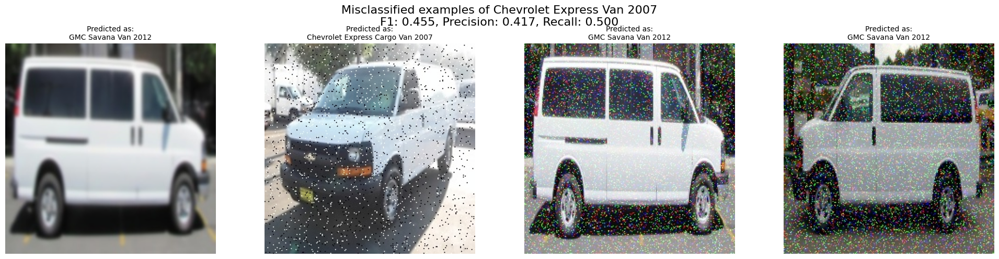



Analysis for: Aston Martin Virage Convertible 2012
F1 Score: 0.462
Precision: 0.600
Recall: 0.375

Most common misclassifications:
- Confused with BMW M6 Convertible 2010: 8 times
- Confused with Aston Martin V8 Vantage Convertible 2012: 7 times
- Confused with MINI Cooper Roadster Convertible 2012: 3 times


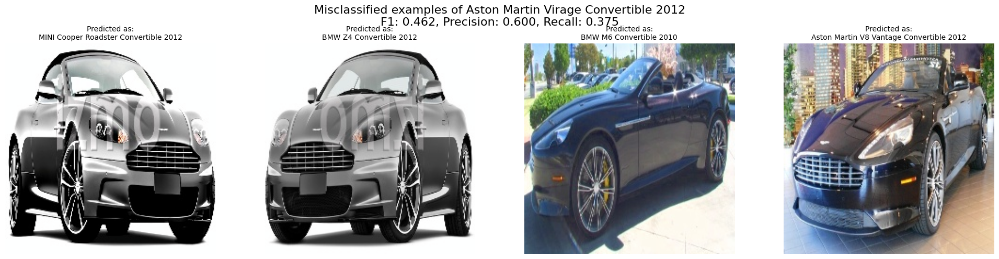



Analysis for: Audi TTS Coupe 2012
F1 Score: 0.468
Precision: 0.500
Recall: 0.440

Most common misclassifications:
- Confused with Audi TT Hatchback 2011: 22 times
- Confused with Audi TT RS Coupe 2012: 4 times
- Confused with Audi S5 Coupe 2012: 1 times


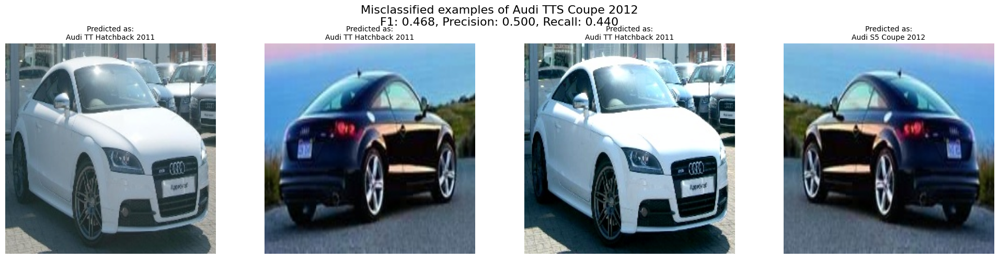



Analysis for: Audi S4 Sedan 2012
F1 Score: 0.486
Precision: 0.567
Recall: 0.425

Most common misclassifications:
- Confused with Audi TT RS Coupe 2012: 10 times
- Confused with BMW Z4 Convertible 2012: 3 times
- Confused with Audi S5 Coupe 2012: 2 times


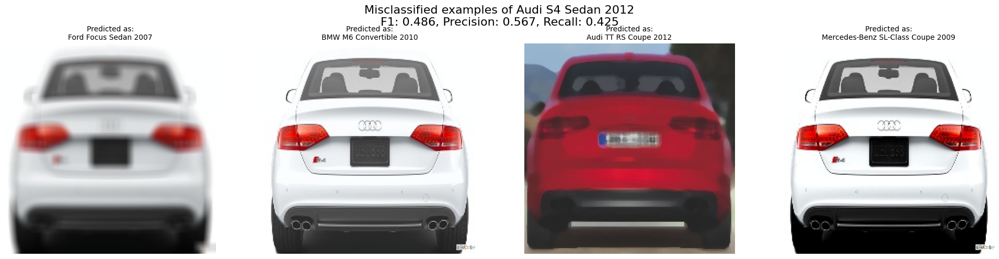



Analysis for: Audi TT Hatchback 2011
F1 Score: 0.534
Precision: 0.470
Recall: 0.620

Most common misclassifications:
- Confused with Audi TTS Coupe 2012: 19 times


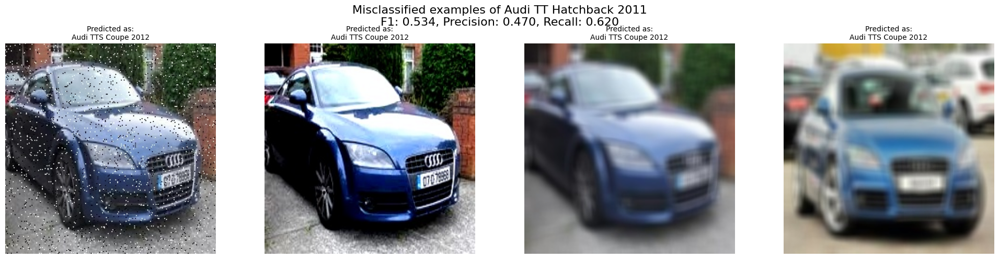



Analysis for: Chevrolet Silverado 1500 Regular Cab 2012
F1 Score: 0.534
Precision: 0.470
Recall: 0.620

Most common misclassifications:
- Confused with Chevrolet Silverado 2500HD Regular Cab 2012: 16 times
- Confused with Chevrolet Silverado 1500 Hybrid Crew Cab 2012: 2 times
- Confused with Chevrolet Silverado 1500 Classic Extended Cab 2007: 1 times


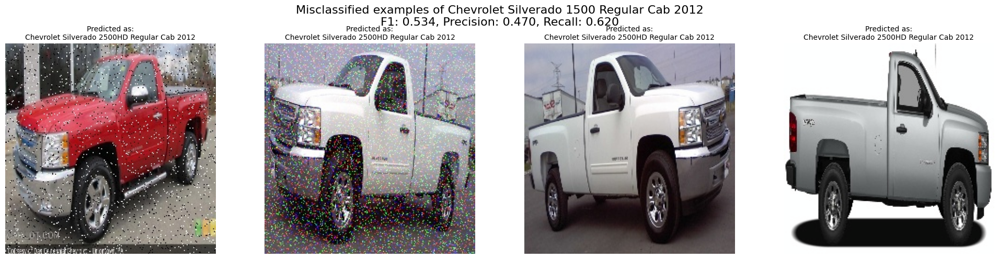



Analysis for: Chevrolet Silverado 1500 Extended Cab 2012
F1 Score: 0.542
Precision: 0.565
Recall: 0.520

Most common misclassifications:
- Confused with Chevrolet Silverado 1500 Hybrid Crew Cab 2012: 23 times
- Confused with Chevrolet Silverado 2500HD Regular Cab 2012: 1 times


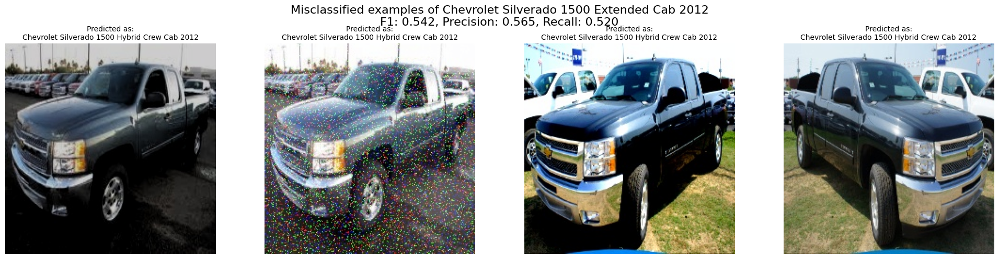


Summary of Bottom 10 Classes:

Class | F1 Score | Precision | Recall | Top Confusion | # Misclassifications
------------------------------------------------------------------------------------------
Chevrolet Express Cargo Van 20 | 0.000 | 0.000 | 0.000 | Chevrolet Express Va | 30
Chevrolet Silverado 2500HD Reg | 0.349 | 0.417 | 0.300 | Chevrolet Silverado  | 35
Chevrolet Silverado 1500 Hybri | 0.449 | 0.408 | 0.500 | Chevrolet Silverado  | 20
Chevrolet Express Van 2007     | 0.455 | 0.417 | 0.500 | GMC Savana Van 2012  | 20
Aston Martin Virage Convertibl | 0.462 | 0.600 | 0.375 | BMW M6 Convertible 2 | 25
Audi TTS Coupe 2012            | 0.468 | 0.500 | 0.440 | Audi TT Hatchback 20 | 28
Audi S4 Sedan 2012             | 0.486 | 0.567 | 0.425 | Audi TT RS Coupe 201 | 23
Audi TT Hatchback 2011         | 0.534 | 0.470 | 0.620 | Audi TTS Coupe 2012  | 19
Chevrolet Silverado 1500 Regul | 0.534 | 0.470 | 0.620 | Chevrolet Silverado  | 19
Chevrolet Silverado 1500 Exten | 0.542 | 0.565 | 0.52

In [20]:
# Get the bottom 10 classes from sklearn metrics F1 analysis
bottom_10_indices = np.argsort(f1)[:10]
bottom_10_classes = [class_name_list[i] for i in bottom_10_indices]

# Dictionary to store misclassifications and their patterns
misclassified_data = {cls: {
    'examples': [],
    'confusion_matrix': {},
    'f1_score': f1[idx],
    'precision': precision[idx],  # Add precision
    'recall': recall[idx]        # Add recall
} for idx, cls in zip(bottom_10_indices, bottom_10_classes)}

# Collect misclassified examples
efficientnet_model.eval()
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = efficientnet_model(images)
        _, predicted = torch.max(outputs, 1)
        
        for img, pred, true_label in zip(images, predicted, labels):
            true_idx = true_label.item()
            pred_idx = pred.item()
            
            if true_idx in bottom_10_indices and pred_idx != true_idx:
                true_class = class_name_list[true_idx]
                pred_class = class_name_list[pred_idx]
                
                # Denormalize image
                img_np = img.cpu().numpy().transpose(1, 2, 0)
                img_np = img_np * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
                img_np = np.clip(img_np, 0, 1)
                
                # Store misclassified example
                misclassified_data[true_class]['examples'].append({
                    'image': img_np,
                    'predicted': pred_class
                })
                
                # Update confusion matrix
                if pred_class not in misclassified_data[true_class]['confusion_matrix']:
                    misclassified_data[true_class]['confusion_matrix'][pred_class] = 0
                misclassified_data[true_class]['confusion_matrix'][pred_class] += 1

# Analyze each bottom class
for class_name in bottom_10_classes:
    data = misclassified_data[class_name]
    
    print(f"\n{'='*80}")
    print(f"\nAnalysis for: {class_name}")
    print(f"F1 Score: {data['f1_score']:.3f}")
    print(f"Precision: {data['precision']:.3f}")
    print(f"Recall: {data['recall']:.3f}")
    
    # Show most common misclassifications
    print("\nMost common misclassifications:")
    sorted_confusions = sorted(data['confusion_matrix'].items(), 
                             key=lambda x: x[1], reverse=True)
    for wrong_class, count in sorted_confusions[:3]:
        print(f"- Confused with {wrong_class}: {count} times")
    
    # Visualize examples
    if data['examples']:
        plt.figure(figsize=(20, 5))
        plt.suptitle(f'Misclassified examples of {class_name}\n' + 
                    f'F1: {data["f1_score"]:.3f}, ' +
                    f'Precision: {data["precision"]:.3f}, ' +
                    f'Recall: {data["recall"]:.3f}', 
                    fontsize=16)
        
        n_examples = min(4, len(data['examples']))
        for i in range(n_examples):
            example = data['examples'][i]
            plt.subplot(1, n_examples, i + 1)
            plt.imshow(example['image'])
            plt.title(f"Predicted as:\n{example['predicted']}", 
                     fontsize=10, wrap=True)
            plt.axis('off')
        plt.tight_layout()
        plt.show()

# Print summary table
print("\nSummary of Bottom 10 Classes:")
print("\nClass | F1 Score | Precision | Recall | Top Confusion | # Misclassifications")
print("-" * 90)
for class_name in bottom_10_classes:
    data = misclassified_data[class_name]
    top_confusion = max(data['confusion_matrix'].items(), 
                       key=lambda x: x[1]) if data['confusion_matrix'] else ("None", 0)
    total_misclassifications = sum(data['confusion_matrix'].values())
    
    print(f"{class_name[:30]:<30} | {data['f1_score']:.3f} | {data['precision']:.3f} | {data['recall']:.3f} | " +
          f"{top_confusion[0][:20]:<20} | {total_misclassifications}")

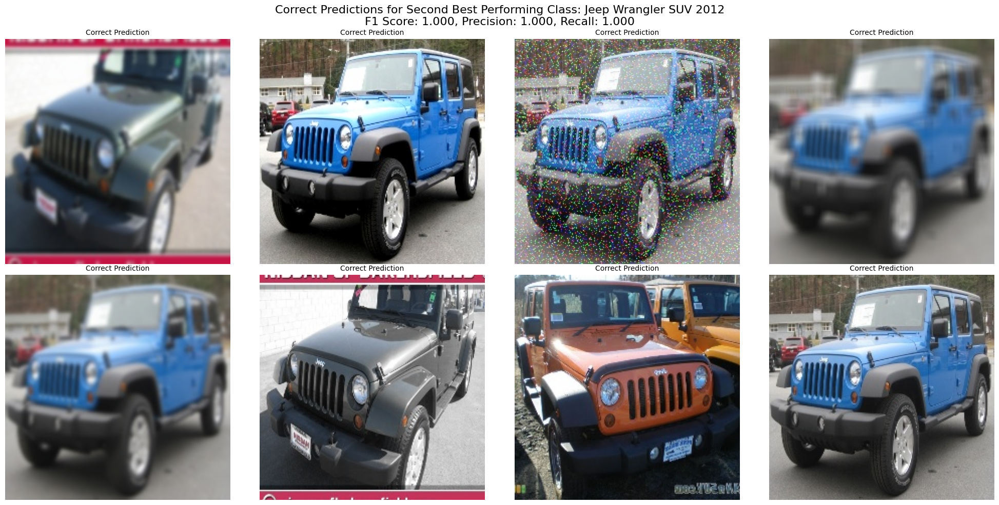


Performance Metrics for Jeep Wrangler SUV 2012:
F1 Score: 1.000
Precision: 1.000
Recall: 1.000


In [21]:
# Get the second best performing class based on F1 score
sorted_indices = np.argsort(f1)[::-1]  # Sort in descending order
second_best_idx = sorted_indices[1]
second_best_class = class_name_list[second_best_idx]

# Find correct predictions for the second best class
efficientnet_model.eval()
correct_examples = []
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        mask = (labels == second_best_idx)
        if not mask.any():
            continue
            
        outputs = efficientnet_model(images[mask])
        _, predicted = torch.max(outputs, 1)
        
        # Keep correct predictions
        correct_predictions = predicted == labels[mask]
        if not correct_predictions.any():
            continue
            
        for img in images[mask][correct_predictions][:8]:  # Limit to 8 examples
            # Denormalize image
            img_np = img.cpu().numpy().transpose(1, 2, 0)
            img_np = img_np * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
            img_np = np.clip(img_np, 0, 1)
            correct_examples.append(img_np)

# Display correct predictions
if correct_examples:
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Correct Predictions for Second Best Performing Class: {second_best_class}\n' + 
                f'F1 Score: {f1[second_best_idx]:.3f}, ' +
                f'Precision: {precision[second_best_idx]:.3f}, ' +
                f'Recall: {recall[second_best_idx]:.3f}', 
                fontsize=16)
    
    for i, img in enumerate(correct_examples[:8]):  # Show up to 8 examples
        plt.subplot(2, 4, i+1)
        plt.imshow(img)
        plt.title(f'Correct Prediction', fontsize=10)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Print performance metrics
    print(f"\nPerformance Metrics for {second_best_class}:")
    print(f"F1 Score: {f1[second_best_idx]:.3f}")
    print(f"Precision: {precision[second_best_idx]:.3f}")
    print(f"Recall: {recall[second_best_idx]:.3f}")